# Installation

In [ ]:
import micropip
await micropip.install('coreflow')
await micropip.install('nbformat==5.1.2')

In [ ]:
package_list = micropip.list()
print(package_list)

# JBN (Johnson-Bossler-Naumann) Analysis

Johnson, E.F., D.P. Bossler, and V.O. Naumann. Calculation of Relative Permeability from Displacement Experiments, 1959. Transactions of the American Institute of Mining, Metallurgical, and Petroleum Engineers. Vol. 216, 370-372. <br>
https://doi.org/10.2118/1023-G

Data sources <br>
https://www.jgmaas.com/ <br>
https://www.scores-panterra.nl/Views/sca_papers.php

In [2]:
import os

import numpy as np
import pandas as pd
from scipy import optimize

from coreflow import Plot, Analytics, BuckleyLeverett

## Experiment Setup

In [3]:
# Core diemnsions
length = 6 # cm
diameter = 3.81 # cm
area = np.pi*(diameter**2)/4 # cm2

# Rock properties
porosity = 0.25
permeability = 200 # mD
pore_volume = porosity*area*length # cm3

# Fluid Properties
visc_wet_phase = 1     # viscosity of wetting phase, cP
visc_non_wet_phase = 1 # viscosity of non-wetting phase, cP

# Experiment setup
sat_wet_init = 0.2
inj_rate = 1710/24 # cc/h

# Relative permeability data
sirr_wet_phase = 0.12       # residual saturation of wetting phase
sirr_non_wet_phase = 0.15   # residual saturation of non-wetting phase
kr_max_wet_phase = 0.1      # end-point of wetting phase relative permeability
kr_max_non_wet_phase = 0.8  # end-point of non-wetting phase relative permeability

tbt = 477 # breakthrough time (according to the pressure drop plot), s

# Convertion factors
atm2bar = 1.01325

print(f"Core Length = {length} cm")
print(f"Core Area = {area} cm2")
print(f"Viscosity of Wetting Phase = {visc_wet_phase} cP")
print(f"Viscosity of Non-Wetting Phase = {visc_non_wet_phase} cP")
print(f"Pore Volume = {pore_volume} cm3")
print(f"Injection rate = {inj_rate} cm3/h")

Core Length = 6 cm
Core Area = 11.400918279693698 cm2
Viscosity of Wetting Phase = 1 cP
Viscosity of Non-Wetting Phase = 1 cP
Pore Volume = 17.101377419540547 cm3
Injection rate = 71.25 cm3/h


# Measured Data

In [4]:
data_dir = 'data'
filename = os.path.join(data_dir,'USS_CASE2.xlsx')
df = pd.read_excel(filename)
time_col = 'time [s]'
dp_col = 'dP [bar]'
q_inj_col = 'Qinj [cm3]'
q_wet_phase_col = 'Qw [cm3]'
q_non_wet_phase_col = 'Qo [cm3]'
df

,time [s],dP [bar],Qinj [cm3],Qo [cm3],Qw [cm3]
0,0,0.000,0.000000,0.00000,0.000000
1,6,0.102,0.115158,0.10087,0.014288
2,87,0.202,1.718115,1.70060,0.017515
3,163,0.295,3.223073,3.20240,0.020673
4,223,0.369,4.422646,4.39970,0.022946
5,284,0.443,5.624792,5.59920,0.025592
6,375,0.555,7.427417,7.39830,0.029117
7,436,0.629,8.631344,8.59970,0.031644
8,472,0.672,9.333156,9.30010,0.033056
9,477,0.678,9.433302,9.40010,0.033202


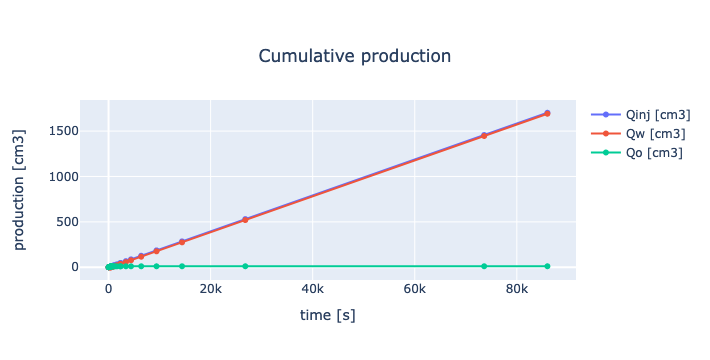

In [5]:
p = Plot.plot(df[time_col].values, (
    ({"name": q_inj_col, "values": df[q_inj_col].values},
    {"name": q_wet_phase_col, "values": df[q_wet_phase_col].values},
    {"name": q_non_wet_phase_col, "values": df[q_non_wet_phase_col].values},)),
    xaxis_title="time [s]",
    yaxis_title="production [cm3]",
    title="Cumulative production", 
    #plot_with = "matplotlib",
    #plot_with = "bokeh",
    #plot_with = "plotly",
    #show=False,
    )

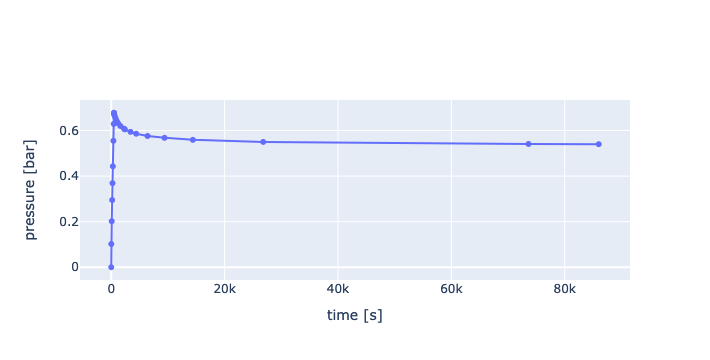

In [6]:
p = Plot.plot(df[time_col].values,
    ({"name": dp_col, "values": df[dp_col].values},),
    xaxis_title="time [s]",
    yaxis_title="pressure [bar]",
    #plot_with = "matplotlib",
    #plot_with = "bokeh",
    #plot_with = "plotly",
    #show=False,
    )

# Relative permeabilities interpretation

Johnson-Bossler-Naumann (JBN) method <br><br>
Phase velocities $u_{w}(L,t)$ and $u_{nw}(L,t)$ at the outlet at time $t$ (production rates):
$$
u_{w}(L,t) = \frac{1}{A}\frac{d Q_{w}}{dt} \\
$$
$$
u_{nw}(L,t) = \frac{1}{A}\frac{d Q_{nw}}{dt}
$$
Saturation $S_w(L,t)$ at the outlet at time $t$:
$$
S_w(L,t) = S_{wc} + \frac{1}{A L \phi}\left(t\frac{d Q_{w}(t)}{dt}-Q_{w}(t)\right)
$$
Relative permabilities ratio:
$$
\frac{k_{rw}}{k_{rnw}} = \frac{\mu_{w}}{\mu_{nw}} \frac{u_{w}(L,t)}{u_{nw}(L,t)}
$$
Relative permabilities:
$$
{k_{rw}} = \frac{\mu_{w} L u_{w}(L,t)}{K}  \left(\Delta P(t) - t\frac{\Delta P(t)}{dt}\right)^{-1}
$$
$$
{k_{rnw}} = \frac{\mu_{nw} L u_{nw}(L,t)}{K}  \left(\Delta P(t) - t\frac{\Delta P(t)}{dt}\right)^{-1}
$$

In [7]:
# JBN analysis
jbn_solution = Analytics.interpret_relperms(
    t=df[time_col].values / 3600,     # hours
    dp=df[dp_col].values,              # bar
    q_wet_phase=df[q_wet_phase_col].values, # cc
    q_non_wet_phase=df[q_non_wet_phase_col].values, # cc
    visc_wet_phase=visc_wet_phase,
    visc_non_wet_phase=visc_non_wet_phase,
    sat_wet_init=sat_wet_init,
    length=length,
    area=area,
    permeability=permeability,
    porosity=porosity,
)

s = jbn_solution.sat_wet
kr_wet_phase = jbn_solution.kr_wet_phase
kr_non_wet_phase = jbn_solution.kr_non_wet_phase

In [8]:
relperms = pd.DataFrame(data={
    's': s,
    'kr_wet': kr_wet_phase,
    'kr_non_wet': kr_non_wet_phase,
})
relperms

,s,kr_wet,kr_non_wet
0,0.199235,0.006095,0.591777
1,0.199183,0.001141,0.554138
2,0.199172,0.001123,0.557906
3,0.199188,0.001126,0.548770
4,0.199178,0.001134,0.550921
5,0.199171,0.001104,0.547572
6,0.199185,0.001050,0.507013
7,0.199116,0.000939,0.482381
8,0.559841,0.058336,0.032045
9,0.696613,0.065085,0.007372


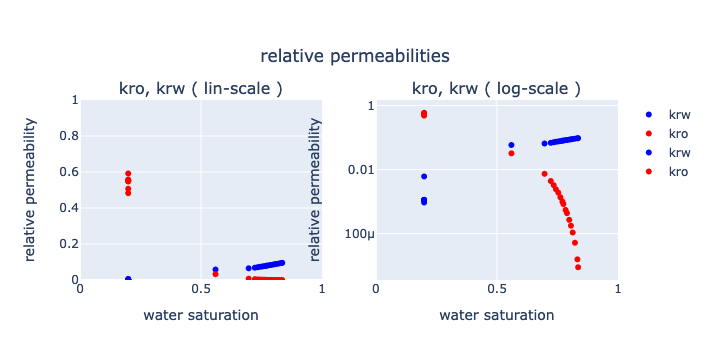

In [9]:
p = Plot.plot_relperms(s, (
    {"name": "krw", "values": kr_wet_phase, "tags": {"water","ref"}},
    {"name": "kro", "values": kr_non_wet_phase, "tags": {"oil", "ref"}}),
    lin_scale=True,
    log_scale=True,
    #plot_with = "matplotlib",
    #plot_with = "bokeh",
    #plot_with = "plotly",
    #show=False,
    )

## Fit relative permeabilities using Corey functions

In [10]:
# corey relperms
def kr_corey(s, n, krmax=1.0, swir=0.0, soir=0.0, is_wetting=True):
    seff = (s - swir) / (1.0 - soir - swir)
    return krmax * np.power(seff, n) if is_wetting else krmax * np.power(1.0 - seff, n)

#### Fit relative permeability of injected phase

In [11]:
# fit kr or injected phase
kr_func = lambda x, n: kr_corey(x, n, kr_max_wet_phase, sirr_wet_phase, sirr_non_wet_phase, is_wetting = True)
popt, pcov = optimize.curve_fit(lambda x, n: np.log10(kr_func(x, n)),
                            relperms["s"].values,
                            np.log10(relperms["kr_wet"].values),
                            1,
                            bounds=((1,5)),
                           )
n_wet_phase = popt[0]
kr_wet_func = lambda x: kr_corey(x, n_wet_phase, kr_max_wet_phase, sirr_wet_phase, sirr_non_wet_phase, is_wetting = True)
print(f"nw = {n_wet_phase}")

nw = 1.933471877983721


#### Fit relative permeability of displaced phase

In [12]:
# fit kr of displaced phase
kr_func = lambda x, n: kr_corey(x, n, kr_max_non_wet_phase, sirr_non_wet_phase, sirr_non_wet_phase, is_wetting = False)
popt, pcov = optimize.curve_fit(lambda x, n: np.log10(kr_func(x, n)),
                            relperms["s"].values,
                            np.log10(relperms["kr_non_wet"].values),
                            1,
                            bounds=((1,5)),
                           )
n_non_wet_phase = popt[0]
kr_non_wet_func = lambda x: kr_corey(x, n_non_wet_phase, kr_max_non_wet_phase, sirr_non_wet_phase, sirr_non_wet_phase, is_wetting = False)
print(f"no = {n_non_wet_phase}")

no = 3.0301883351449415


In [13]:
print(f"nw = {n_wet_phase}, no={n_non_wet_phase}")

nw = 1.933471877983721, no=3.0301883351449415


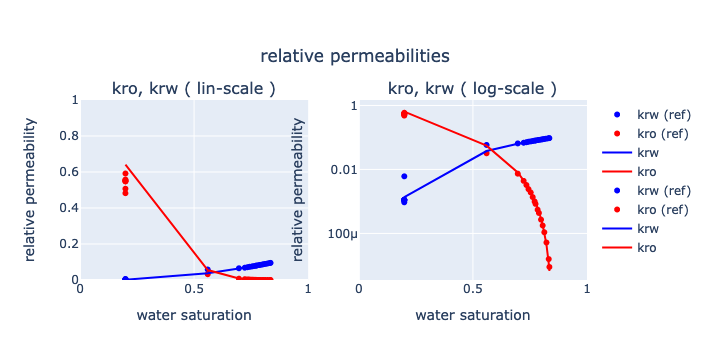

In [14]:
p = Plot.plot_relperms(s, (
    {"name": "krw (ref)", "values": relperms["kr_wet"].values, "tags": {"water","ref"}},
    {"name": "kro (ref)", "values": relperms["kr_non_wet"].values, "tags": {"oil", "ref"}},
    {"name": "krw", "values": kr_wet_func(relperms["s"].values), "tags": {"water"}},
    {"name": "kro", "values": kr_non_wet_func(relperms["s"].values), "tags": {"oil"}},
    ),
    lin_scale=True,
    log_scale=True,
    #plot_with = "matplotlib",
    #plot_with = "bokeh",
    #plot_with = "plotly",
    #show=False,
    )

# Buckley-Leverett Solution

Buckley-Leverett equation:
$$
-\frac {df_w}{dS_w} \frac{\partial S_w}{\partial x} = \frac {A\phi}{q}\frac{\partial S_w}{\partial t}
$$
$S_w(x,t)$:
$$
dS_w = \frac{\partial S_w}{\partial x}dx + \frac{\partial S_w}{\partial t}dt
$$
Fluid front is of constant saturation, hence:
$$
0 = \frac{\partial S_w}{\partial x}dx + \frac{\partial S_w}{\partial t}dt
$$
Substituting it to Buckley-Leverett equation, gives:
$$
\frac{dx}{dt} = \frac{q}{A\phi}\frac{df_w}{dS_w}
$$
Integrating both sides over time from $t=0$ to $t=t$:
$$
\int_{t=0} ^{t=t} \frac{dx}{dt}dt = \int_{t=0} ^{t=t}\frac{q}{A\phi}\frac{df_w}{dS_w}dt
$$
From which results one gets position of the front $x_f(t)$ at time $t$:
$$
x_f = \frac{q t}{A \phi}(\frac{df_w}{dS_w})_f
$$
whree fractional flow function can be calculated as:
$$
f_w = \frac{1}{1+\frac{k_{ro}}{\mu_o}\frac{\mu_w}{k_{rw}}}
$$

In [15]:
# get time steps
t_before_bt = np.arange(0, tbt, 5)
t_report = df[time_col].values
t = np.union1d(t_before_bt, t_report) / 3600
Tend = df[time_col].values[-1] / 3600

# injected saturation
sat_wet_inj = 1.0 - sirr_non_wet_phase

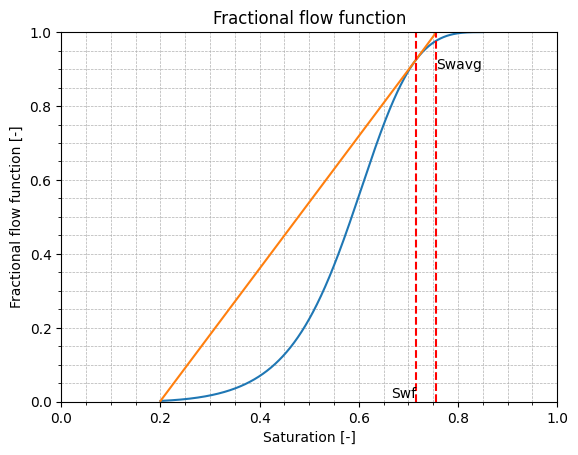

In [16]:
bl_solution = \
    BuckleyLeverett.solve( t,
                           kr_wet_phase=kr_wet_func,
                           kr_non_wet_phase=kr_non_wet_func,
                           visc_wet_phase=visc_wet_phase,
                           visc_non_wet_phase=visc_non_wet_phase,
                           sat_wet_init=sat_wet_init,
                           sat_wet_inj=sat_wet_inj,
                           porosity=porosity,
                           permeability=permeability,
                           length=length,
                           area=area,
                           qt=inj_rate,
                        )
x_calc = bl_solution.x
sat_calc = bl_solution.sat_wet
dp_calc = bl_solution.dp
savg_calc = bl_solution.sat_wet_avg
q_wet_phase_calc = bl_solution.q_wet_phase
q_non_wet_phase_calc = bl_solution.q_non_wet_phase

#### Compare Buckley Leverett Solution with Measured data

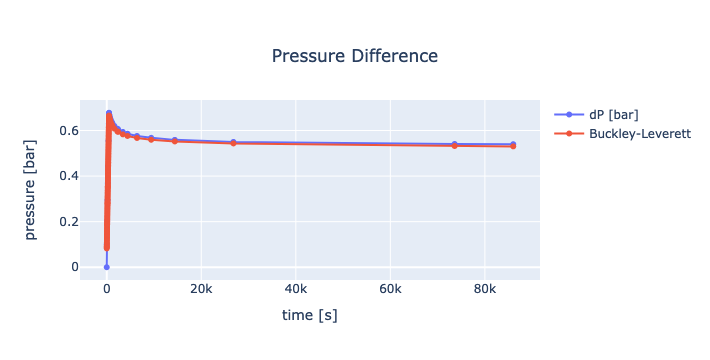

In [17]:
p = Plot.plot(((df[time_col].values,{"name": dp_col, "values": df[dp_col].values}),
               (t*3600,{"name": "Buckley-Leverett", "values": dp_calc})),
    title="Pressure Difference",
    xaxis_title="time [s]",
    yaxis_title="pressure [bar]",
    #plot_with = "matplotlib",
    #plot_with = "bokeh",
    #plot_with = "plotly",
    #show=False,
    )

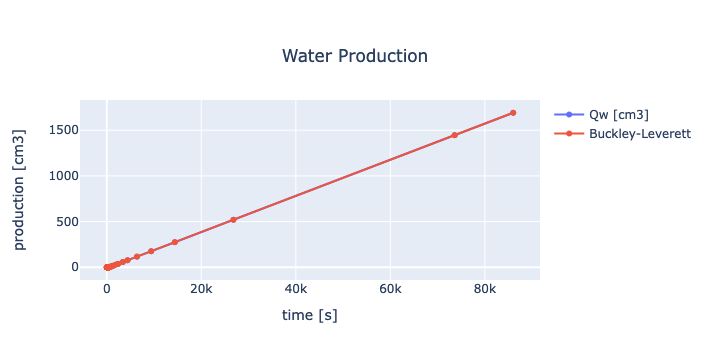

In [18]:
p = Plot.plot(((df[time_col].values,{"name": q_wet_phase_col, "values": df[q_wet_phase_col].values}),
               (t*3600,{"name": "Buckley-Leverett", "values": q_wet_phase_calc})),
    title="Water Production",
    xaxis_title="time [s]",
    yaxis_title="production [cm3]",
    #plot_with = "matplotlib",
    #plot_with = "bokeh",
    #plot_with = "plotly",
    #show=False,
    )

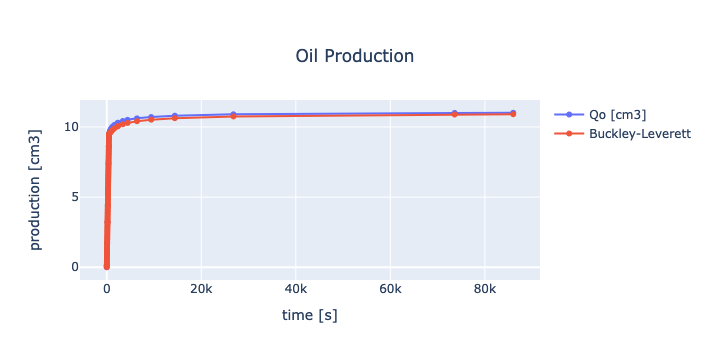

In [19]:
p = Plot.plot(((df[time_col].values,{"name": q_non_wet_phase_col, "values": df[q_non_wet_phase_col].values}),
               (t*3600,{"name": "Buckley-Leverett", "values": q_non_wet_phase_calc})),
    title="Oil Production",
    xaxis_title="time [s]",
    yaxis_title="production [cm3]",
    #plot_with = "matplotlib",
    #plot_with = "bokeh",
    #plot_with = "plotly",
    #show=False,
    )

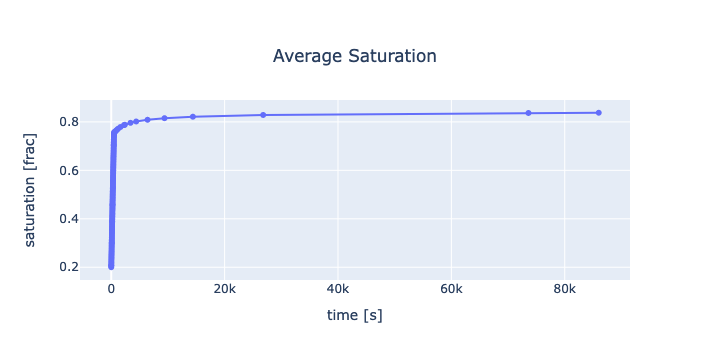

In [20]:
p = Plot.plot(((t*3600,{"name": "Buckley-Leverett", "values": savg_calc}),),
    title="Average Saturation",
    xaxis_title="time [s]",
    yaxis_title="saturation [frac]",
    #plot_with = "matplotlib",
    #plot_with = "bokeh",
    #plot_with = "plotly",
    #show=False,
    )

## Plots

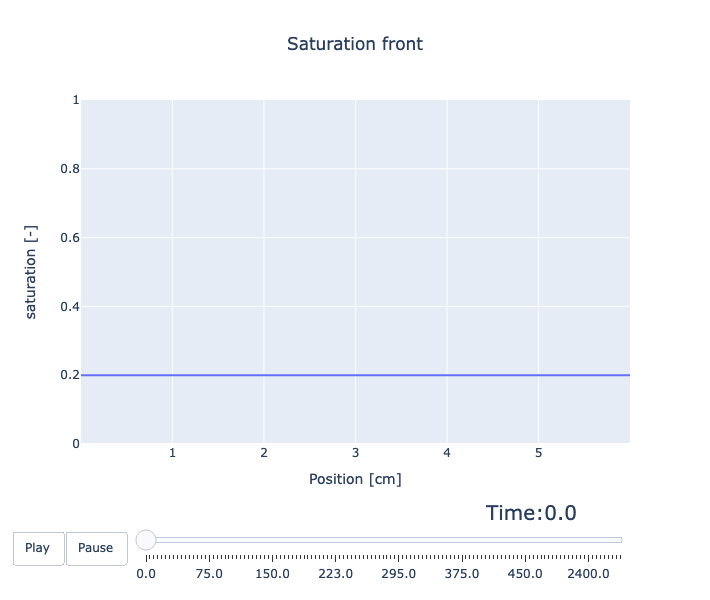

In [21]:
Plot.animate_solution(t*3600, x_calc, sat_calc,
                      yaxis_range=[0,1],
                      title="Saturation front",
                      xaxis_title="Position [cm]",
                      yaxis_title="saturation [-]",
                      #plot_with = "matplotlib",
                      #plot_with = "bokeh",
                      #plot_with = "plotly",
                      )